In [5]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from scipy import sparse
import datetime

import plotly

from plotly.graph_objs import *

plotly.offline.init_notebook_mode(connected=True)
%matplotlib inline

In [6]:


map_air = {'stationId': 'station_id', 'utc_time': 'time', 'PM2.5': 'PM25_Concentration', 'PM10': 'PM10_Concentration', 'NO2': 'NO2_Concentration', 'CO': 'CO_Concentration', 'O3': 'O3_Concentration', 'SO2': 'SO2_Concentration'}
map_grid = {'stationName': 'station_id', 'utc_time': 'time','wind_speed/kph':'wind_speed'}
map_weather = { 'utc_time': 'time'}


df1 = pd.read_csv('data/aiqQuality_201804.csv')
df2 = pd.read_csv('data/airQuality_201701-201801.csv').rename(columns=map_air)
df3 = pd.read_csv('data/airQuality_201802-201803.csv').rename(columns=map_air)
df4 = pd.read_csv('data/external_0501-0502.csv').sort_values(by='time').drop_duplicates(subset=['station_id','time'])
airq = pd.concat([df2, df3, df1,df4], axis = 0) 

df1 = pd.read_csv('data/gridWeather_201804.csv')
df2 = pd.read_csv('data/gridWeather_201701-201803.csv').rename(columns=map_grid)
df3 = pd.read_csv('data/gridWeather_20180501-20180502.csv')
grid =  pd.concat([df2, df1,df3], axis = 0) 

df1 = pd.read_csv('data/observedWeather_201802-201803.csv').rename(columns=map_weather)
df2 = pd.read_csv('data/observedWeather_201701-201801.csv').rename(columns=map_weather)
df3 = pd.read_csv('data/observedWeather_201804.csv')
observe = pd.concat([df1,df2,df3],axis = 0)

/home/1/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


/home/1/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


/home/1/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.


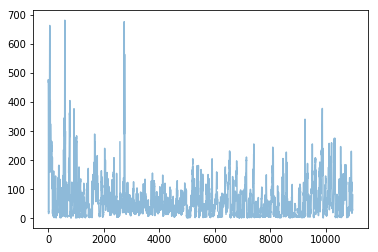

In [33]:
test_df = df.sort_values(by='time').loc[df.station_id == 'dongsi_aq']
test_attr = 'PM25_Concentration'
plt.plot(test_df[test_attr].values,alpha=0.5)
#plt.plot(test_df[test_attr].values,alpha=0.2)

In [9]:
groups = airq.groupby('station_id')
out = []
test_attr = 'PM25_Concentration'

for key,group in groups:
    dic = {'name':key}
    dic['x'] = group.time
    dic['y'] = group[test_attr]
    out.append(dic)
    
    dic = {'name':key+'_median'}
    dic['x'] = group.time
    dic['y'] = group[test_attr].rolling(5,center=True).median()
    out.append(dic)
    break
plotly.offline.iplot(out)

In [77]:
groups = df4.groupby('station_id')
out2 = []
test_attr = 'PM25_Concentration'

for key,group in groups:
    dic = {'name':key}
    
    group = group.sort_values(by='time')
    #print(len(group))
    #print(group)
    dic['x'] = group.time
    dic['y'] = group[test_attr]
    out2.append(dic)
plotly.offline.iplot(out2)

In [22]:
pywt.wavelist()

['bior1.1',
 'bior1.3',
 'bior1.5',
 'bior2.2',
 'bior2.4',
 'bior2.6',
 'bior2.8',
 'bior3.1',
 'bior3.3',
 'bior3.5',
 'bior3.7',
 'bior3.9',
 'bior4.4',
 'bior5.5',
 'bior6.8',
 'cgau1',
 'cgau2',
 'cgau3',
 'cgau4',
 'cgau5',
 'cgau6',
 'cgau7',
 'cgau8',
 'cmor',
 'coif1',
 'coif2',
 'coif3',
 'coif4',
 'coif5',
 'coif6',
 'coif7',
 'coif8',
 'coif9',
 'coif10',
 'coif11',
 'coif12',
 'coif13',
 'coif14',
 'coif15',
 'coif16',
 'coif17',
 'db1',
 'db2',
 'db3',
 'db4',
 'db5',
 'db6',
 'db7',
 'db8',
 'db9',
 'db10',
 'db11',
 'db12',
 'db13',
 'db14',
 'db15',
 'db16',
 'db17',
 'db18',
 'db19',
 'db20',
 'db21',
 'db22',
 'db23',
 'db24',
 'db25',
 'db26',
 'db27',
 'db28',
 'db29',
 'db30',
 'db31',
 'db32',
 'db33',
 'db34',
 'db35',
 'db36',
 'db37',
 'db38',
 'dmey',
 'fbsp',
 'gaus1',
 'gaus2',
 'gaus3',
 'gaus4',
 'gaus5',
 'gaus6',
 'gaus7',
 'gaus8',
 'haar',
 'mexh',
 'morl',
 'rbio1.1',
 'rbio1.3',
 'rbio1.5',
 'rbio2.2',
 'rbio2.4',
 'rbio2.6',
 'rbio2.8',
 'rbio3.1',

In [12]:
pywt.wavelist()

['haar',
 'db',
 'sym',
 'coif',
 'bior',
 'rbio',
 'dmey',
 'gaus',
 'mexh',
 'morl',
 'cgau',
 'shan',
 'fbsp',
 'cmor']

In [14]:
import pywavelet

ModuleNotFoundError: No module named 'pywavelet'

In [56]:
data = pd.DataFrame({'a':[1,1,2,3,100,2,3,1,1]})

In [57]:
data

,a
0,1
1,1
2,2
3,3
4,100
5,2
6,3
7,1
8,1


In [61]:
data.rolling(5,center = True,min_periods= 3).median()

,a
0,1.0
1,1.5
2,2.0
3,2.0
4,3.0
5,3.0
6,2.0
7,1.5
8,1.0


In [62]:
groups = airq.groupby('station_id')
out = []
test_attr = 'PM25_Concentration'
bad = ['Sleet','HAZE','Hail']
for key,group in groups:
    dic = {'name':key}
    dic['x'] = group.time
    dic['y'] = group[test_attr]
    out.append(dic)
    '''
    grid_group=grid_groups.get_group('beijing_grid_304')
    dic = {'name':'bad_weather_window'}
    dic['x'] = grid_group.time
    dic['y'] = grid_group['weather'].apply(lambda x : 500 if x in bad else 0)
    out.append(dic)
    
    dic = {'name':key+'roll'}
    dic['x'] = group.time
    dic['y'] = group[test_attr].rolling(3,center = True).median() 
    out.append(dic)
    '''
    break
plotly.offline.iplot(out)

In [16]:
grid_groups = grid.groupby('station_id')
out = []
test_attr = 'weather'
key= 'beijing_grid_304'

#for key,group in groups:

grid_group=grid_groups.get_group(key)
dic = {'name':key}
dic['x'] = grid_group.time
dic['y'] = grid_group[test_attr]
out.append(dic)
plotly.offline.iplot(out)

In [14]:
grid_groups = grid.groupby('station_id')
out = []
test_attr = 'pressure'
key= 'beijing_grid_304'

#for key,group in groups:

grid_group=grid_groups.get_group(key)
dic = {'name':key}
dic['x'] = grid_group.time
dic['y'] = grid_group[test_attr]
out.append(dic)
plotly.offline.iplot(out)

In [45]:
t = airq['PM25_Concentration'][(airq.time < '2018-05-1 0:00:00')& (airq.time > '2018-02-1 00:00:00')]

In [35]:
airq['PM25_Concentration'][(airq.time < '2018-05-1 0:00:00')& (airq.time > '2018-02-1 00:00:00')].std()

68.62638604626493

In [41]:
grid.weather.unique()

array([nan, 'CLEAR_DAY', 'HAZE', 'PARTLY_CLOUDY_DAY', 'WIND', 'CLOUDY',
       'CLEAR_NIGHT', 'PARTLY_CLOUDY_NIGHT', 'RAIN', 'SNOW'], dtype=object)

In [44]:
np.where(grid.weather == 'RAIN')

(array([7063118, 7063159, 7063663, ..., 7523547, 7523548, 7523549]),)

In [27]:
from sklearn.feature_selection import f_regression

In [30]:
groups = airq.groupby('station_id')
out = []
test_attr = 'PM25_Concentration'
target = ['humidity','pressure','temperature','wind_speed']
for key,group in groups:
    grid_group=grid_groups.get_group('beijing_grid_304')
    mer = group.merge(grid_group,how='left',on='time').fillna(method='ffill')
    x = mer.loc[:,target].values
    y = mer.loc[:,test_attr].values
    print(f_regression(x,y))
    break

(array([1003.00019306,  115.40339307,    1.08023221,  788.37622544]), array([9.49622851e-211, 8.71555110e-027, 2.98668437e-001, 1.33594088e-167]))


In [59]:
airq['date'] = airq.time.apply(lambda x: pd.to_datetime(x))
airq['year'] = airq['date'].dt.year
airq['month'] = airq['date'].dt.month
airq['day'] = airq['date'].dt.day

In [49]:
df1 = airq[(airq['year'] == 2017) & (airq['month'] == 4)]
df2 = airq[(airq['year'] == 2018) & (airq['month'] == 4)]
df1[test_attr].mean(),df1[test_attr].std(),df2[test_attr].mean(),df2[test_attr].std()

(57.08362399720963, 48.36186881988826, 62.696942242355604, 60.56300236743522)

In [56]:
df1 = airq[(airq['year'] == 2017) & (airq['month'] <= 3)]
df2 = airq[(airq['year'] == 2018) & (airq['month'] <= 3)]
df1[test_attr].mean(),df1[test_attr].std(),df2[test_attr].mean(),df2[test_attr].std()

(87.06839266773234, 97.6504224734245, 62.78677417073343, 65.23789625636407)

In [54]:
df1 = airq[(airq['weekday'] <= 5) & (airq['year'] == 2017) & (airq['month'] <= 4)]
df2 = airq[(airq['weekday'] <= 5) & (airq['year'] == 2018)]
df1[test_attr].mean(),df1[test_attr].std(),df2[test_attr].mean(),df2[test_attr].std()

(81.18527818575197, 90.65696037746797, 60.38696588395565, 65.31660468876554)

In [55]:
df1 = airq[(airq['weekday'] > 5) & (airq['year'] == 2017) & (airq['month'] <= 4)]
df2 = airq[(airq['weekday'] > 5) & (airq['year'] == 2018)]
df1[test_attr].mean(),df1[test_attr].std(),df2[test_attr].mean(),df2[test_attr].std()

(75.19712262729738, 83.7427410719315, 66.73883714690889, 59.683469541096386)

In [61]:
df1 = airq[(airq['year'] == 2018) & (airq['month'] == 4)& (airq['day'] > 4) & (airq['day'] < 8)]
df2 = airq[(airq['weekday'] > 5) & (airq['year'] == 2018) & (airq['month'] == 4)& (airq['day'] > 10)]
df1[test_attr].mean(),df1[test_attr].std(),df2[test_attr].mean(),df2[test_attr].std()

(28.55043227665706, 22.043088342747847, 55.00776078520886, 59.30600494774109)